In [1]:
import torch
import sys
import types
from torchvision.transforms.functional import to_tensor, to_pil_image, rgb_to_grayscale
from PIL import Image
import torchvision.transforms as transforms
import torchvision.datasets as dset
import os
import kagglehub
import numpy as np
from tqdm import tqdm
import torch.nn as nn
import torch.optim as optim
import torch.nn.utils.spectral_norm as spectral_norm
from torchvision.models import vgg19, VGG19_Weights
import time
from torch.utils.data import DataLoader, Dataset
import glob
import torch.nn.functional as F
import torchvision
import matplotlib.pyplot as plt
import json

# Create a module for `torchvision.transforms.functional_tensor`
functional_tensor = types.ModuleType("torchvision.transforms.functional_tensor")
functional_tensor.rgb_to_grayscale = rgb_to_grayscale

# Add this module to sys.modules so other imports can access it
sys.modules["torchvision.transforms.functional_tensor"] = functional_tensor
from basicsr.archs.rrdbnet_arch import RRDBNet


In [2]:
num_epochs = 25
batch_size = 16
upscale_factor = 4  # Scale factor in generator
lr_img_size = 64
hr_img_size = lr_img_size * upscale_factor
dataset_lenght = 5000
lr = 0.0001
gen_num_block = 6

# === Step 1: Set Paths ===
base_path = os.path.expanduser("~/real-esrgan-imitation-training-data") 
lr_path = os.path.join(base_path, "lr_images")
hr_path = os.path.join(base_path, f"hr{'+' if upscale_factor==4 else ''}_images")

# Training Dataset Preperation

In [3]:
# Check if dataset has already been created
if not os.path.exists(lr_path) or not os.path.exists(hr_path) or len(os.listdir(lr_path)) == 0 or len(os.listdir(hr_path)) == 0:
    print("🚀 Creating dataset, as it's missing or incomplete...")

    # Create directories if they don't exist
    os.makedirs(lr_path, exist_ok=True)
    os.makedirs(hr_path, exist_ok=True)
    
    # === Step 2: Get Device ===
    def get_device():
        if torch.cuda.is_available():
            return torch.device("cuda")
        elif torch.backends.mps.is_available():
            return torch.device("mps")
        else:
            return torch.device("cpu")
    
    device = get_device()
    
    # === Step 3: Load Pretrained Real-ESRGAN Model ===
    model = RRDBNet(num_in_ch=3, num_out_ch=3, num_feat=64, num_block=6, num_grow_ch=32, scale=4).to(device)
    
    checkpoint = torch.load("../Real-ESRGAN/weights/RealESRGAN_x4plus_anime_6B.pth", map_location=device)
    if 'params_ema' in checkpoint:
        model.load_state_dict(checkpoint["params_ema"], strict=True)
    else:
        model.load_state_dict(checkpoint, strict=True)
    model.eval()
    
    # === Step 4: Load Kaggle Dataset ===
    dataset_name = "soumikrakshit/anime-faces"
    path = kagglehub.dataset_download(dataset_name)
    dataset = dset.ImageFolder(root=path, 
                              transform=transforms.Compose([
                                  transforms.Resize(64),
                                  transforms.CenterCrop(64),
                              ]))
    
    # === Step 5: Select 10,000 Random Images ===
    image_indices = np.random.choice(len(dataset), size=dataset_lenght, replace=False)
    
    # === Step 6: Process and Save Images ===
    for i in tqdm(range(1, dataset_lenght+1), desc="Processing Images", unit="image"):
        idx = image_indices[i - 1]  # Ensure correct indexing
    
        # Load image
        lr_image = dataset[idx][0]  # Low-resolution (64x64)
        
        # Convert to tensor & send to device
        img_tensor = to_tensor(lr_image).unsqueeze(0).to(device)
    
        # Generate high-resolution image (256x256)
        with torch.no_grad():
            output_tensor = model(img_tensor).clamp(0,1)
    
        # Convert to PIL image
        hr_image_256 = to_pil_image(output_tensor.squeeze(0))
    
        # Save images in ~/vision-project-images/
        lr_image.save(os.path.join(lr_path, f"{i}.png"))  # Save as 64x64
        hr_image_256.save(os.path.join(hr_path, f"{i}.png"))  # Save as 128x128
    
    print(f"✅ Low-resolution images saved in: {lr_path}")
    print(f"✅ High-resolution images saved in: {hr_path}")


else:
    print("✅ Dataset already exists. Skipping dataset creation.")


✅ Dataset already exists. Skipping dataset creation.


# Dataset & Dataloader

In [4]:
# Custom Dataset for Anime Faces
class AnimeFaceDataset(Dataset):
    def __init__(self, lr_folder, hr_folder, lr_size, hr_size):
        self.lr_images = sorted(glob.glob(os.path.join(lr_folder, "*.png")))
        self.hr_images = sorted(glob.glob(os.path.join(hr_folder, "*.png")))
        
        # Basic transforms
        self.lr_transform = transforms.Compose([
            transforms.Resize(lr_size),
            transforms.ToTensor()
        ])
        self.hr_transform = transforms.Compose([
            transforms.Resize(hr_size),
            transforms.ToTensor()
        ])

    
    def __len__(self):
        return len(self.hr_images)
    
    def __getitem__(self, idx):
        lr_img = Image.open(self.lr_images[idx]).convert('RGB')
        hr_img = Image.open(self.hr_images[idx]).convert('RGB')
        
        # Create low-resolution version
        lr_img = self.lr_transform(hr_img)
        
        # Transform high-resolution image
        hr_img = self.hr_transform(hr_img)
        
        return lr_img, hr_img

In [5]:
dataset = AnimeFaceDataset(lr_path, hr_path, lr_size=(lr_img_size, lr_img_size), hr_size=(hr_img_size, hr_img_size))
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Generator

In [6]:
def get_device():
    if torch.cuda.is_available():
        return torch.device("cuda")
    elif torch.backends.mps.is_available():
        return torch.device("mps")
    else:
        return torch.device("cpu")

device = get_device()

In [7]:
# Helper function to initialize weights
@torch.no_grad()
def default_init_weights(module_list, scale=1, bias_fill=0, **kwargs):
    if not isinstance(module_list, list):
        module_list = [module_list]
    for module in module_list:
        for m in module.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, **kwargs)
                m.weight.data *= scale
                if m.bias is not None:
                    m.bias.data.fill_(bias_fill)
            elif isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, **kwargs)
                m.weight.data *= scale
                if m.bias is not None:
                    m.bias.data.fill_(bias_fill)
            elif isinstance(m, _BatchNorm):
                init.constant_(m.weight, 1)
                if m.bias is not None:
                    m.bias.data.fill_(bias_fill)

# Pixel Unshuffle for downsampling
def pixel_unshuffle(x, scale):
    b, c, hh, hw = x.size()
    out_channel = c * (scale**2)
    assert hh % scale == 0 and hw % scale == 0
    h = hh // scale
    w = hw // scale
    x_view = x.view(b, c, h, scale, w, scale)
    return x_view.permute(0, 1, 3, 5, 2, 4).reshape(b, out_channel, h, w)



In [8]:
# RRDBNet (Residual in Residual Dense Block Network) architecture
class ResidualDenseBlock(nn.Module):
    def __init__(self, channels=64, growth_channels=32):
        super(ResidualDenseBlock, self).__init__()
        self.conv1 = nn.Conv2d(channels, growth_channels, kernel_size=3, stride=1, padding=1)
        self.conv2 = nn.Conv2d(channels + growth_channels, growth_channels, kernel_size=3, stride=1, padding=1)
        self.conv3 = nn.Conv2d(channels + 2 * growth_channels, growth_channels, kernel_size=3, stride=1, padding=1)
        self.conv4 = nn.Conv2d(channels + 3 * growth_channels, growth_channels, kernel_size=3, stride=1, padding=1)
        self.conv5 = nn.Conv2d(channels + 4 * growth_channels, channels, kernel_size=3, stride=1, padding=1)
        self.lrelu = nn.LeakyReLU(negative_slope=0.2, inplace=True)
        self.beta = 0.2  # Scaling factor
        
        # initialization
        default_init_weights([self.conv1, self.conv2, self.conv3, self.conv4, self.conv5], 0.1)
        
        
    def forward(self, x):
        x1 = self.lrelu(self.conv1(x))
        x2 = self.lrelu(self.conv2(torch.cat((x, x1), 1)))
        x3 = self.lrelu(self.conv3(torch.cat((x, x1, x2), 1)))
        x4 = self.lrelu(self.conv4(torch.cat((x, x1, x2, x3), 1)))
        x5 = self.conv5(torch.cat((x, x1, x2, x3, x4), 1))
        return x5 * self.beta + x

In [9]:
class RRDB(nn.Module):
    def __init__(self, channels=64):
        super(RRDB, self).__init__()
        self.rdb1 = ResidualDenseBlock(channels)
        self.rdb2 = ResidualDenseBlock(channels)
        self.rdb3 = ResidualDenseBlock(channels)
        self.beta = 0.2
        
    def forward(self, x):
        out = self.rdb1(x)
        out = self.rdb2(out)
        out = self.rdb3(out)
        return out * self.beta + x

In [10]:
# Generator Network
class Generator(nn.Module):
    def __init__(self, num_in_ch=3, num_out_ch=3, scale=2, num_feat=64, num_block=6, num_grow_ch=32):
        super(Generator, self).__init__()
        self.scale = scale
        if scale == 2:
            num_in_ch = num_in_ch * 4
        elif scale == 1:
            num_in_ch = num_in_ch * 16
            
        self.conv_first = nn.Conv2d(num_in_ch, num_feat, 3, 1, 1)
        self.body = nn.Sequential(*[RRDB(num_feat) for _ in range(num_block)])
        self.conv_body = nn.Conv2d(num_feat, num_feat, 3, 1, 1)
        
        # upsample
        self.conv_up1 = nn.Conv2d(num_feat, num_feat, 3, 1, 1)
        self.conv_up2 = nn.Conv2d(num_feat, num_feat, 3, 1, 1)
        self.conv_hr = nn.Conv2d(num_feat, num_feat, 3, 1, 1)
        self.conv_last = nn.Conv2d(num_feat, num_out_ch, 3, 1, 1)

        self.lrelu = nn.LeakyReLU(negative_slope=0.2, inplace=True)

    def forward(self, x):
        if self.scale == 2:
            feat = pixel_unshuffle(x, scale=2)
        elif self.scale == 1:
            feat = pixel_unshuffle(x, scale=4)
        else:
            feat = x
            
        feat = self.conv_first(feat)
        body_feat = self.conv_body(self.body(feat))
        feat = feat + body_feat
        
        # upsample
        feat = self.lrelu(self.conv_up1(F.interpolate(feat, scale_factor=2, mode='nearest')))
        feat = self.lrelu(self.conv_up2(F.interpolate(feat, scale_factor=2, mode='nearest')))
        out = self.conv_last(self.lrelu(self.conv_hr(feat)))
        
        return out

# Discriminator

In [11]:
class Discriminator(nn.Module):
    def __init__(self, num_input=3, num_feat=64, skip_connection=True):
        super(Discriminator, self).__init__()
        self.skip_connection = skip_connection
        norm = spectral_norm
        self.conv0 = nn.Conv2d(num_input, num_feat, 3, 1, 1)  # Assume the input image has a resolution of 256x256 (can also be 128x128)
        self.conv1 = norm(nn.Conv2d(num_feat, num_feat * 2, 4, 2, 1, bias=False))  # 256x256 --> 128x128
        self.conv2 = norm(nn.Conv2d(num_feat * 2, num_feat * 4, 4, 2, 1, bias=False))  # 128x128 --> 64x64
        self.conv3 = norm(nn.Conv2d(num_feat * 4, num_feat * 8, 4, 2, 1, bias=False))  # 64x64 --> 32x32
        self.conv4 = norm(nn.Conv2d(num_feat * 8, num_feat * 4, 3, 1, 1, bias=False))  # 32x32 --> 32x32
        self.conv5 = norm(nn.Conv2d(num_feat * 4, num_feat * 2, 3, 1, 1, bias=False))  # 32x32 --> 32x32
        self.conv6 = norm(nn.Conv2d(num_feat * 2, num_feat, 3, 1, 1, bias=False))  # 32x32 --> 32x32
        self.conv7 = norm(nn.Conv2d(num_feat, num_feat, 3, 1, 1, bias=False))  # 32x32 --> 32x32
        self.conv8 = norm(nn.Conv2d(num_feat, num_feat, 3, 1, 1, bias=False))  # 32x32 --> 32x32
        self.conv9 = norm(nn.Conv2d(num_feat, 1, 3, 1, 1, bias=False))  # 32x32 --> 32x32

    def forward(self, x):
        y1 = F.leaky_relu(self.conv0(x), 0.2, inplace=True)
        y2 = F.leaky_relu(self.conv1(y1), 0.2, inplace=True)
        y3 = F.leaky_relu(self.conv2(y2), 0.2, inplace=True)
        y4 = F.leaky_relu(self.conv3(y3), 0.2, inplace=True)
        y4 = F.interpolate(y4, scale_factor=2, mode='bilinear', align_corners=False)  # 32x32 --> 64x64
        y5 = F.leaky_relu(self.conv4(y4), 0.2, inplace=True)
        if self.skip_connection:
            y5 = y5 + y3
        y5 = F.interpolate(y5, scale_factor=2, mode='bilinear', align_corners=False)  # 64x64 --> 128x128
        y6 = F.leaky_relu(self.conv5(y5), 0.2, inplace=True)
        if self.skip_connection:
            y6 = y6 + y2
        y6 = F.interpolate(y6, scale_factor=2, mode='bilinear', align_corners=False)  # 128x128 --> 256x256
        y7 = F.leaky_relu(self.conv6(y6), 0.2, inplace=True)
        if self.skip_connection:
            y7 = y7 + y1
        y8 = F.leaky_relu(self.conv7(y7), 0.2, inplace=True)
        y9 = F.leaky_relu(self.conv8(y8), 0.2, inplace=True)
        out = self.conv9(y9)
        
        return out

# Loss Function

In [12]:
adversarial_loss = nn.BCEWithLogitsLoss().to(device)
content_loss = nn.MSELoss().to(device)

In [13]:
def relativistic_loss(real_pred, fake_pred):
    real_loss = adversarial_loss(real_pred - torch.mean(fake_pred), torch.ones_like(real_pred))
    fake_loss = adversarial_loss(fake_pred - torch.mean(real_pred), torch.zeros_like(fake_pred))
    out = (real_loss + fake_loss) / 2
    return out

In [14]:
class perceptual_loss(nn.Module):
    def __init__(self):
        super(perceptual_loss, self).__init__()
        # vgg = vgg19(pretrained=True)
        vgg = vgg19(weights=VGG19_Weights.IMAGENET1K_V1)
        self.feature_extractor = nn.Sequential(*list(vgg.features[:36])).eval()
        for param in self.feature_extractor.parameters():
            param.requires_grad = False

    def forward(self, x, target):
        x_features = self.feature_extractor(x)
        target_features = self.feature_extractor(target)
        loss = nn.functional.l1_loss(x_features, target_features)
        return loss

In [15]:
generator = Generator(num_in_ch=3, num_out_ch=3, scale=upscale_factor, num_feat=64, num_block=gen_num_block, num_grow_ch=32).to(device)
generator

Generator(
  (conv_first): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (body): Sequential(
    (0): RRDB(
      (rdb1): ResidualDenseBlock(
        (conv1): Conv2d(64, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv2): Conv2d(96, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv3): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv4): Conv2d(160, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv5): Conv2d(192, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (lrelu): LeakyReLU(negative_slope=0.2, inplace=True)
      )
      (rdb2): ResidualDenseBlock(
        (conv1): Conv2d(64, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv2): Conv2d(96, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv3): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (conv4): Conv2d(160, 32, kernel_size=(3, 3), stride=(1, 1)

In [16]:
discriminator = Discriminator().to(device)
discriminator

Discriminator(
  (conv0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv1): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (conv2): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (conv3): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  (conv4): Conv2d(512, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (conv5): Conv2d(256, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (conv6): Conv2d(128, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (conv7): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (conv8): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (conv9): Conv2d(64, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
)

In [17]:
feature_extractor = perceptual_loss().to(device)
feature_extractor

perceptual_loss(
  (feature_extractor): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3)

In [18]:
optimizer_g = optim.Adam(generator.parameters(), lr=lr)
optimizer_d = optim.Adam(discriminator.parameters(),lr=lr)

In [19]:
scheduler_g = optim.lr_scheduler.StepLR(optimizer_g, step_size=10, gamma=0.5)
scheduler_d = optim.lr_scheduler.StepLR(optimizer_d, step_size = 10, gamma=0.5)

In [20]:
os.makedirs("upscaled_images", exist_ok=True)

def plot_and_save_images(lr_images, sr_images, epoch, save_path='upscaled_images'):
    original_grid = torchvision.utils.make_grid(lr_images[:6].cpu(), nrow=6)
    enhanced_grid = torchvision.utils.make_grid(sr_images[:6].cpu(), nrow=6)

    original_np = original_grid.numpy().transpose((1, 2, 0))
    enhanced_np = enhanced_grid.numpy().transpose((1, 2, 0))

    plt.figure(figsize=(12, 5))
    # plt.suptitle(f'Comparison of Original and Enhanced Images (Epoch {epoch}, {upscale_factor}x Upscale)', fontsize=16)

    plt.subplot(2, 1, 1)
    plt.imshow(original_np)
    plt.title('Original Low-Resolution Images')
    plt.axis('off')

    plt.subplot(2, 1, 2)
    plt.imshow(enhanced_np)
    plt.title(f'Enhanced Super-Resolution Images(Epoch {epoch}, {upscale_factor}x Upscale)')
    plt.axis('off')

    plt.savefig(os.path.join(save_path, f'upscaled-images-{upscale_factor}x-epoch-{epoch}.png'))

    plt.tight_layout()
    plt.show()
    plt.close()

# Train

In [21]:
# Initialize lists to store losses
generator_losses = []
discriminator_losses = []

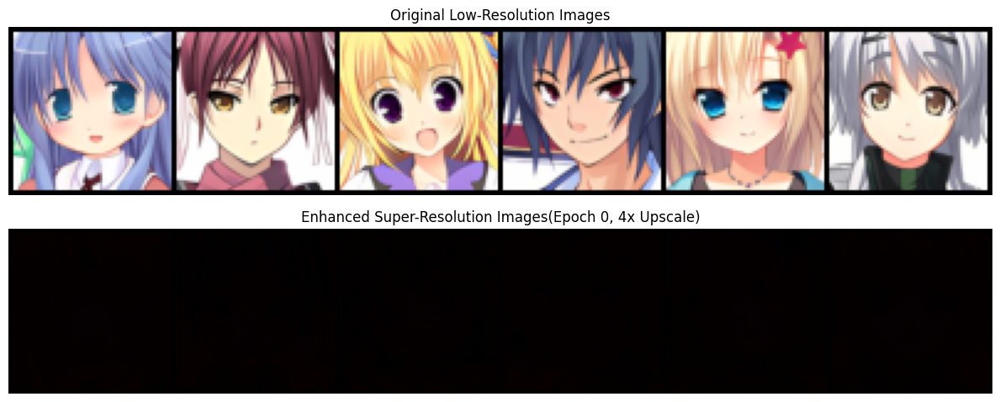

Epoch [1/25], Batch [0/313] => Discriminator Loss: 0.6660, Generator Loss: 0.5305, Batch Time: 8.0533
Epoch [1/25], Batch [10/313] => Discriminator Loss: 2.0837, Generator Loss: 0.0627, Batch Time: 7.0767
Epoch [1/25], Batch [20/313] => Discriminator Loss: 0.7052, Generator Loss: 0.0513, Batch Time: 6.0601
Epoch [1/25], Batch [30/313] => Discriminator Loss: 0.6925, Generator Loss: 0.0437, Batch Time: 5.5043
Epoch [1/25], Batch [40/313] => Discriminator Loss: 0.6889, Generator Loss: 0.0422, Batch Time: 8.3855
Epoch [1/25], Batch [50/313] => Discriminator Loss: 0.6929, Generator Loss: 0.0402, Batch Time: 5.5746
Epoch [1/25], Batch [60/313] => Discriminator Loss: 0.6872, Generator Loss: 0.0396, Batch Time: 4.7362
Epoch [1/25], Batch [70/313] => Discriminator Loss: 0.6895, Generator Loss: 0.0345, Batch Time: 5.2399
Epoch [1/25], Batch [80/313] => Discriminator Loss: 0.6882, Generator Loss: 0.0331, Batch Time: 5.7535
Epoch [1/25], Batch [90/313] => Discriminator Loss: 0.6889, Generator Loss

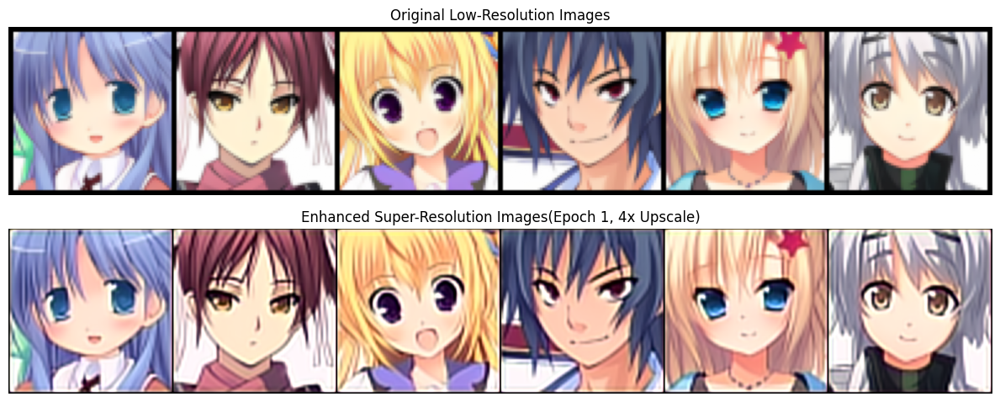

Epoch [2/25], Batch [0/313] => Discriminator Loss: 0.0172, Generator Loss: 0.0115, Batch Time: 4.8619
Epoch [2/25], Batch [10/313] => Discriminator Loss: 0.0140, Generator Loss: 0.0118, Batch Time: 7.5099
Epoch [2/25], Batch [20/313] => Discriminator Loss: 0.0064, Generator Loss: 0.0129, Batch Time: 4.8640
Epoch [2/25], Batch [30/313] => Discriminator Loss: 0.0234, Generator Loss: 0.0120, Batch Time: 4.0572
Epoch [2/25], Batch [40/313] => Discriminator Loss: 0.0044, Generator Loss: 0.0123, Batch Time: 4.8249
Epoch [2/25], Batch [50/313] => Discriminator Loss: 0.0045, Generator Loss: 0.0124, Batch Time: 4.1102
Epoch [2/25], Batch [60/313] => Discriminator Loss: 0.0075, Generator Loss: 0.0115, Batch Time: 4.8622
Epoch [2/25], Batch [70/313] => Discriminator Loss: 0.0062, Generator Loss: 0.0110, Batch Time: 4.0510
Epoch [2/25], Batch [80/313] => Discriminator Loss: 0.0048, Generator Loss: 0.0125, Batch Time: 4.4914
Epoch [2/25], Batch [90/313] => Discriminator Loss: 0.0047, Generator Loss

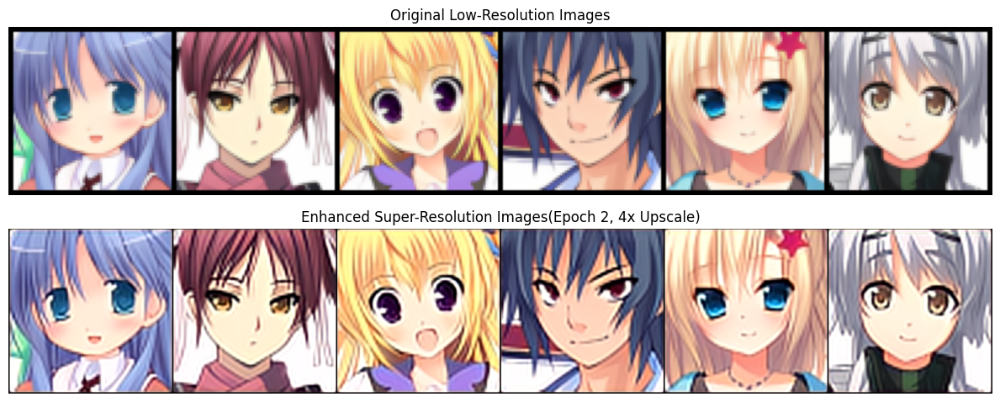

Epoch [3/25], Batch [0/313] => Discriminator Loss: 0.0006, Generator Loss: 0.0108, Batch Time: 6.4319
Epoch [3/25], Batch [10/313] => Discriminator Loss: 0.0020, Generator Loss: 0.0098, Batch Time: 5.3798
Epoch [3/25], Batch [20/313] => Discriminator Loss: 0.0053, Generator Loss: 0.0094, Batch Time: 4.4408
Epoch [3/25], Batch [30/313] => Discriminator Loss: 0.0016, Generator Loss: 0.0103, Batch Time: 4.0088
Epoch [3/25], Batch [40/313] => Discriminator Loss: 0.0023, Generator Loss: 0.0094, Batch Time: 4.0870
Epoch [3/25], Batch [50/313] => Discriminator Loss: 0.0005, Generator Loss: 0.0110, Batch Time: 3.9883
Epoch [3/25], Batch [60/313] => Discriminator Loss: 0.0007, Generator Loss: 0.0103, Batch Time: 5.7183
Epoch [3/25], Batch [70/313] => Discriminator Loss: 0.0133, Generator Loss: 0.0095, Batch Time: 4.1750
Epoch [3/25], Batch [80/313] => Discriminator Loss: 0.2231, Generator Loss: 0.0107, Batch Time: 4.0223
Epoch [3/25], Batch [90/313] => Discriminator Loss: 0.0396, Generator Loss

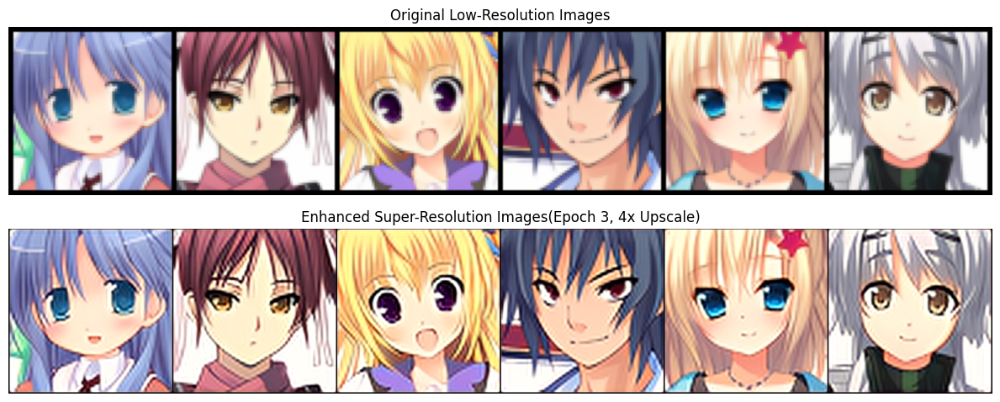

Epoch [4/25], Batch [0/313] => Discriminator Loss: 0.0016, Generator Loss: 0.0094, Batch Time: 14.5652
Epoch [4/25], Batch [10/313] => Discriminator Loss: 0.0010, Generator Loss: 0.0097, Batch Time: 5.3762
Epoch [4/25], Batch [20/313] => Discriminator Loss: 0.0025, Generator Loss: 0.0099, Batch Time: 4.4645
Epoch [4/25], Batch [30/313] => Discriminator Loss: 0.0035, Generator Loss: 0.0098, Batch Time: 4.3302
Epoch [4/25], Batch [40/313] => Discriminator Loss: 0.0058, Generator Loss: 0.0102, Batch Time: 4.8442
Epoch [4/25], Batch [50/313] => Discriminator Loss: 0.0007, Generator Loss: 0.0102, Batch Time: 8.9337
Epoch [4/25], Batch [60/313] => Discriminator Loss: 0.0013, Generator Loss: 0.0116, Batch Time: 5.4740
Epoch [4/25], Batch [70/313] => Discriminator Loss: 0.0016, Generator Loss: 0.0112, Batch Time: 4.7097
Epoch [4/25], Batch [80/313] => Discriminator Loss: 0.0010, Generator Loss: 0.0093, Batch Time: 4.3644
Epoch [4/25], Batch [90/313] => Discriminator Loss: 0.0013, Generator Los

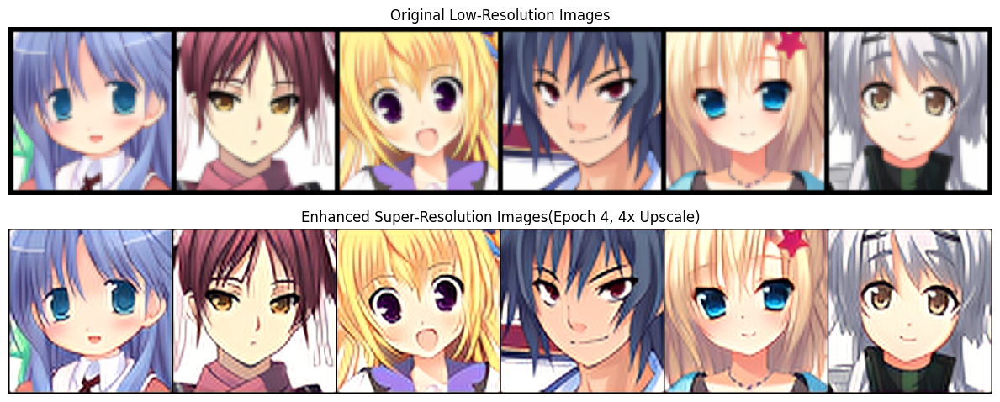

Epoch [5/25], Batch [0/313] => Discriminator Loss: 0.0013, Generator Loss: 0.0090, Batch Time: 5.2780
Epoch [5/25], Batch [10/313] => Discriminator Loss: 0.0016, Generator Loss: 0.0084, Batch Time: 8.2885
Epoch [5/25], Batch [20/313] => Discriminator Loss: 0.0030, Generator Loss: 0.0093, Batch Time: 4.5903
Epoch [5/25], Batch [30/313] => Discriminator Loss: 0.0035, Generator Loss: 0.0088, Batch Time: 4.6154
Epoch [5/25], Batch [40/313] => Discriminator Loss: 0.0015, Generator Loss: 0.0089, Batch Time: 4.0488
Epoch [5/25], Batch [50/313] => Discriminator Loss: 0.0054, Generator Loss: 0.0094, Batch Time: 5.2973
Epoch [5/25], Batch [60/313] => Discriminator Loss: 0.0642, Generator Loss: 0.0087, Batch Time: 4.8601
Epoch [5/25], Batch [70/313] => Discriminator Loss: 0.0582, Generator Loss: 0.0086, Batch Time: 4.0989
Epoch [5/25], Batch [80/313] => Discriminator Loss: 0.0167, Generator Loss: 0.0082, Batch Time: 6.5315
Epoch [5/25], Batch [90/313] => Discriminator Loss: 0.0170, Generator Loss

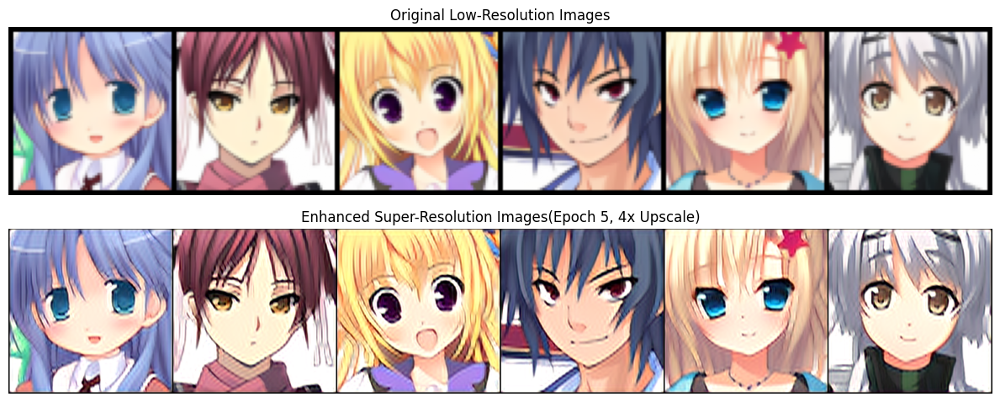

Epoch [6/25], Batch [0/313] => Discriminator Loss: 0.0099, Generator Loss: 0.0105, Batch Time: 5.7675
Epoch [6/25], Batch [10/313] => Discriminator Loss: 0.0312, Generator Loss: 0.0093, Batch Time: 4.8994
Epoch [6/25], Batch [20/313] => Discriminator Loss: 0.0493, Generator Loss: 0.0099, Batch Time: 4.8092
Epoch [6/25], Batch [30/313] => Discriminator Loss: 0.0117, Generator Loss: 0.0103, Batch Time: 4.0101
Epoch [6/25], Batch [40/313] => Discriminator Loss: 0.0226, Generator Loss: 0.0108, Batch Time: 4.0328
Epoch [6/25], Batch [50/313] => Discriminator Loss: 0.0188, Generator Loss: 0.0129, Batch Time: 4.0834
Epoch [6/25], Batch [60/313] => Discriminator Loss: 0.0836, Generator Loss: 0.0164, Batch Time: 4.0229
Epoch [6/25], Batch [70/313] => Discriminator Loss: 0.1240, Generator Loss: 0.0087, Batch Time: 4.1165
Epoch [6/25], Batch [80/313] => Discriminator Loss: 0.0596, Generator Loss: 0.0122, Batch Time: 5.2515
Epoch [6/25], Batch [90/313] => Discriminator Loss: 0.0535, Generator Loss

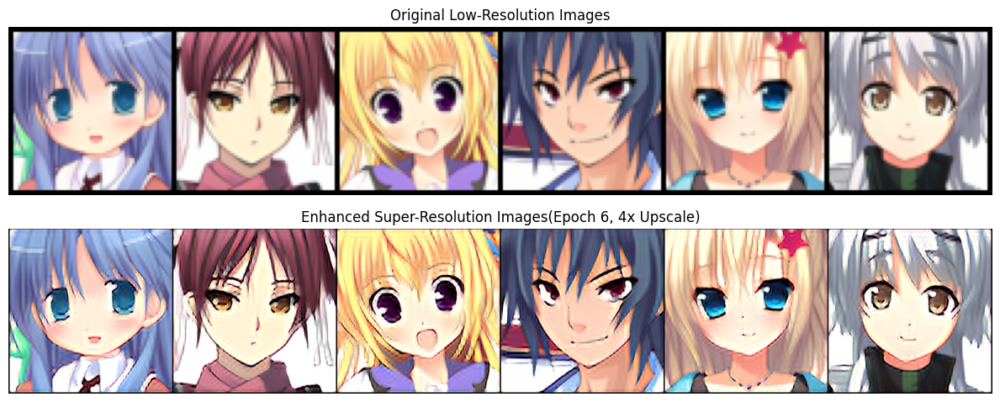

Epoch [7/25], Batch [0/313] => Discriminator Loss: 0.0724, Generator Loss: 0.0105, Batch Time: 8.4749
Epoch [7/25], Batch [10/313] => Discriminator Loss: 0.0660, Generator Loss: 0.0123, Batch Time: 5.5132
Epoch [7/25], Batch [20/313] => Discriminator Loss: 0.0725, Generator Loss: 0.0103, Batch Time: 5.7747
Epoch [7/25], Batch [30/313] => Discriminator Loss: 0.1553, Generator Loss: 0.0097, Batch Time: 5.5097
Epoch [7/25], Batch [40/313] => Discriminator Loss: 0.0842, Generator Loss: 0.0102, Batch Time: 5.4196
Epoch [7/25], Batch [50/313] => Discriminator Loss: 0.0953, Generator Loss: 0.0106, Batch Time: 5.7006
Epoch [7/25], Batch [60/313] => Discriminator Loss: 0.1039, Generator Loss: 0.0111, Batch Time: 5.6643
Epoch [7/25], Batch [70/313] => Discriminator Loss: 0.0267, Generator Loss: 0.0120, Batch Time: 4.6196
Epoch [7/25], Batch [80/313] => Discriminator Loss: 0.1156, Generator Loss: 0.0185, Batch Time: 9.7281
Epoch [7/25], Batch [90/313] => Discriminator Loss: 0.1328, Generator Loss

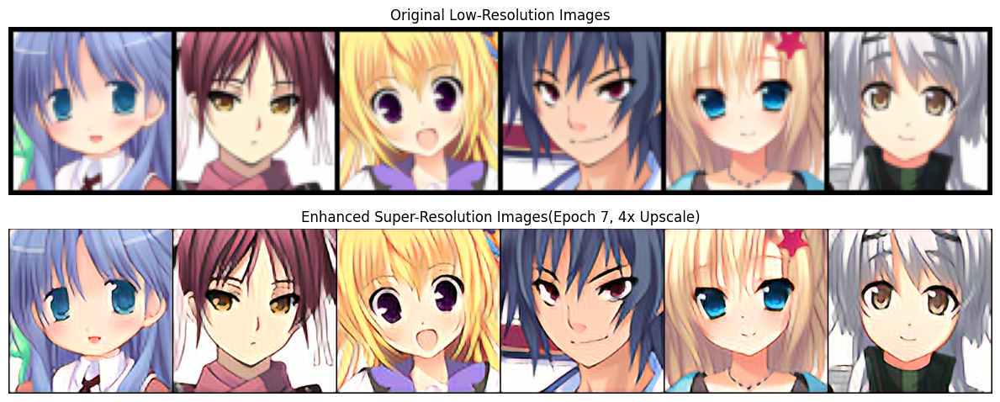

Epoch [8/25], Batch [0/313] => Discriminator Loss: 0.0581, Generator Loss: 0.0110, Batch Time: 9.2441
Epoch [8/25], Batch [10/313] => Discriminator Loss: 0.0368, Generator Loss: 0.0088, Batch Time: 15.5843
Epoch [8/25], Batch [20/313] => Discriminator Loss: 0.0845, Generator Loss: 0.0119, Batch Time: 4.1869
Epoch [8/25], Batch [30/313] => Discriminator Loss: 0.1231, Generator Loss: 0.0091, Batch Time: 4.6210
Epoch [8/25], Batch [40/313] => Discriminator Loss: 0.1379, Generator Loss: 0.0096, Batch Time: 5.5312
Epoch [8/25], Batch [50/313] => Discriminator Loss: 0.1454, Generator Loss: 0.0091, Batch Time: 6.9520
Epoch [8/25], Batch [60/313] => Discriminator Loss: 0.0482, Generator Loss: 0.0088, Batch Time: 4.5552
Epoch [8/25], Batch [70/313] => Discriminator Loss: 0.0432, Generator Loss: 0.0115, Batch Time: 5.1040
Epoch [8/25], Batch [80/313] => Discriminator Loss: 0.1063, Generator Loss: 0.0104, Batch Time: 4.5816
Epoch [8/25], Batch [90/313] => Discriminator Loss: 0.2297, Generator Los

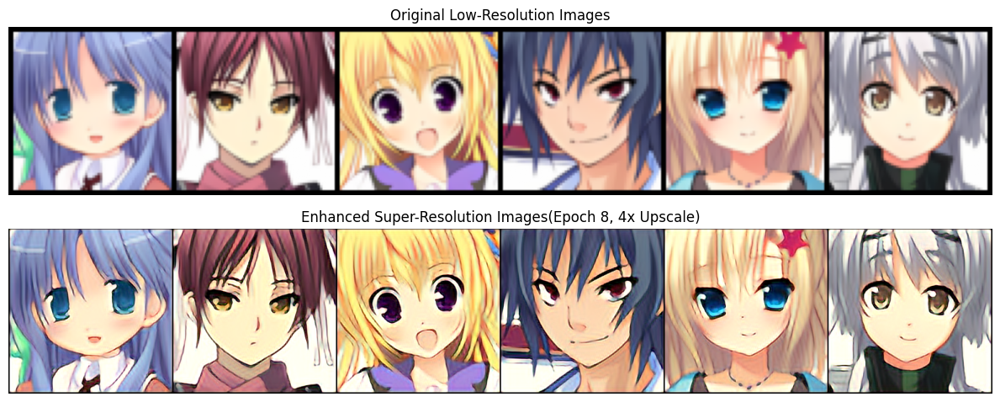

Epoch [9/25], Batch [0/313] => Discriminator Loss: 0.0369, Generator Loss: 0.0156, Batch Time: 5.6209
Epoch [9/25], Batch [10/313] => Discriminator Loss: 0.1299, Generator Loss: 0.0116, Batch Time: 4.0699
Epoch [9/25], Batch [20/313] => Discriminator Loss: 0.0470, Generator Loss: 0.0085, Batch Time: 4.3987
Epoch [9/25], Batch [30/313] => Discriminator Loss: 0.1206, Generator Loss: 0.0102, Batch Time: 4.2033
Epoch [9/25], Batch [40/313] => Discriminator Loss: 0.0938, Generator Loss: 0.0112, Batch Time: 4.0478
Epoch [9/25], Batch [50/313] => Discriminator Loss: 0.1973, Generator Loss: 0.0122, Batch Time: 4.1216
Epoch [9/25], Batch [60/313] => Discriminator Loss: 0.1397, Generator Loss: 0.0079, Batch Time: 4.4431
Epoch [9/25], Batch [70/313] => Discriminator Loss: 0.0599, Generator Loss: 0.0118, Batch Time: 4.2262
Epoch [9/25], Batch [80/313] => Discriminator Loss: 0.0596, Generator Loss: 0.0089, Batch Time: 5.8468
Epoch [9/25], Batch [90/313] => Discriminator Loss: 0.0750, Generator Loss

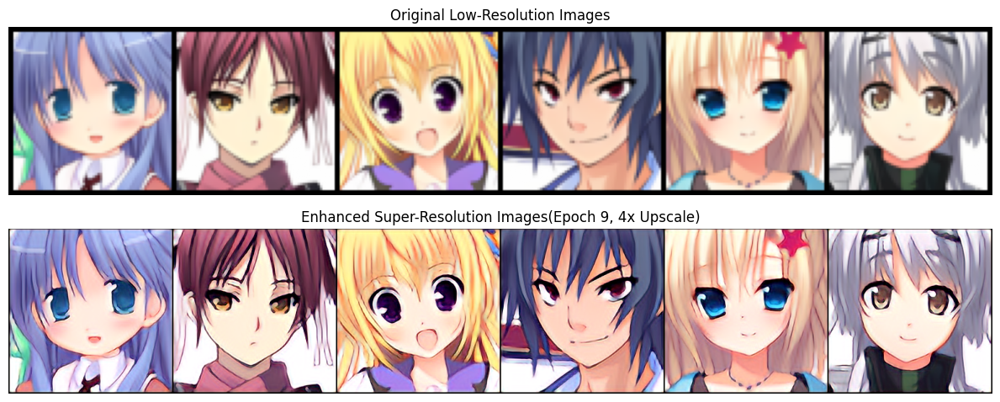

Epoch [10/25], Batch [0/313] => Discriminator Loss: 0.0534, Generator Loss: 0.0083, Batch Time: 5.4357
Epoch [10/25], Batch [10/313] => Discriminator Loss: 0.0940, Generator Loss: 0.0082, Batch Time: 4.6106
Epoch [10/25], Batch [20/313] => Discriminator Loss: 0.1510, Generator Loss: 0.0062, Batch Time: 5.1759
Epoch [10/25], Batch [30/313] => Discriminator Loss: 0.0892, Generator Loss: 0.0090, Batch Time: 4.1934
Epoch [10/25], Batch [40/313] => Discriminator Loss: 0.1314, Generator Loss: 0.0072, Batch Time: 5.8495
Epoch [10/25], Batch [50/313] => Discriminator Loss: 0.0973, Generator Loss: 0.0081, Batch Time: 4.3804
Epoch [10/25], Batch [60/313] => Discriminator Loss: 0.2106, Generator Loss: 0.0091, Batch Time: 5.2203
Epoch [10/25], Batch [70/313] => Discriminator Loss: 0.1240, Generator Loss: 0.0066, Batch Time: 4.8230
Epoch [10/25], Batch [80/313] => Discriminator Loss: 0.1121, Generator Loss: 0.0067, Batch Time: 5.5310
Epoch [10/25], Batch [90/313] => Discriminator Loss: 0.0646, Gene

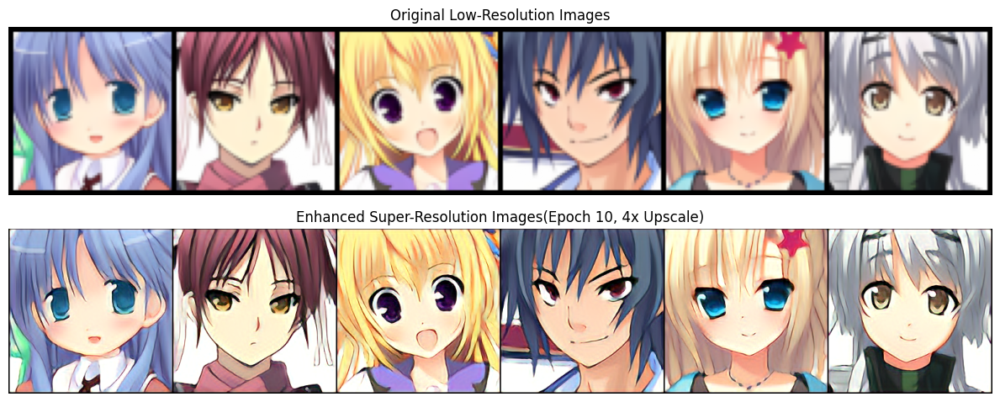

Epoch [11/25], Batch [0/313] => Discriminator Loss: 0.1107, Generator Loss: 0.0065, Batch Time: 5.1587
Epoch [11/25], Batch [10/313] => Discriminator Loss: 0.0736, Generator Loss: 0.0069, Batch Time: 7.7222
Epoch [11/25], Batch [20/313] => Discriminator Loss: 0.1072, Generator Loss: 0.0085, Batch Time: 5.3252
Epoch [11/25], Batch [30/313] => Discriminator Loss: 0.0948, Generator Loss: 0.0072, Batch Time: 6.1188
Epoch [11/25], Batch [40/313] => Discriminator Loss: 0.1432, Generator Loss: 0.0070, Batch Time: 5.6431
Epoch [11/25], Batch [50/313] => Discriminator Loss: 0.1308, Generator Loss: 0.0071, Batch Time: 4.7432
Epoch [11/25], Batch [60/313] => Discriminator Loss: 0.0891, Generator Loss: 0.0086, Batch Time: 4.8809
Epoch [11/25], Batch [70/313] => Discriminator Loss: 0.0873, Generator Loss: 0.0089, Batch Time: 5.9835
Epoch [11/25], Batch [80/313] => Discriminator Loss: 0.0718, Generator Loss: 0.0072, Batch Time: 5.7317
Epoch [11/25], Batch [90/313] => Discriminator Loss: 0.1055, Gene

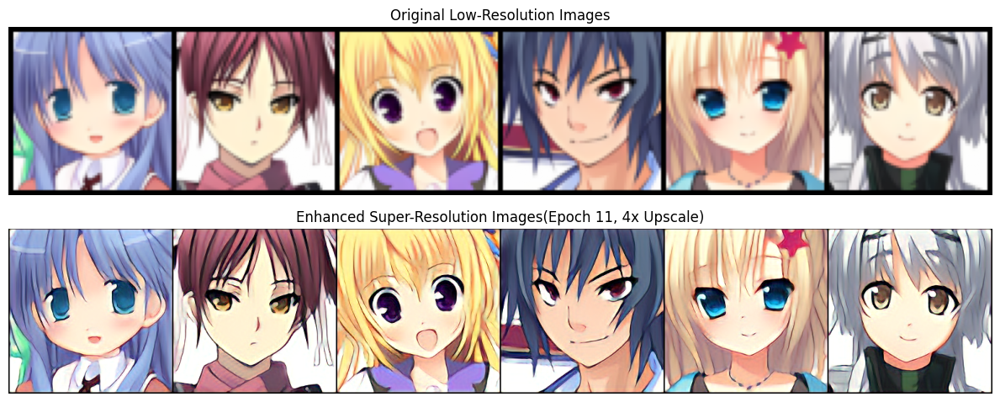

Epoch [12/25], Batch [0/313] => Discriminator Loss: 0.1620, Generator Loss: 0.0061, Batch Time: 5.8559
Epoch [12/25], Batch [10/313] => Discriminator Loss: 0.1720, Generator Loss: 0.0061, Batch Time: 4.4370
Epoch [12/25], Batch [20/313] => Discriminator Loss: 0.0686, Generator Loss: 0.0072, Batch Time: 6.8556
Epoch [12/25], Batch [30/313] => Discriminator Loss: 0.0831, Generator Loss: 0.0090, Batch Time: 7.7651
Epoch [12/25], Batch [40/313] => Discriminator Loss: 0.1049, Generator Loss: 0.0066, Batch Time: 4.5123
Epoch [12/25], Batch [50/313] => Discriminator Loss: 0.1076, Generator Loss: 0.0056, Batch Time: 5.6267
Epoch [12/25], Batch [60/313] => Discriminator Loss: 0.0711, Generator Loss: 0.0069, Batch Time: 4.3328
Epoch [12/25], Batch [70/313] => Discriminator Loss: 0.0628, Generator Loss: 0.0064, Batch Time: 4.9870
Epoch [12/25], Batch [80/313] => Discriminator Loss: 0.1828, Generator Loss: 0.0084, Batch Time: 4.7655
Epoch [12/25], Batch [90/313] => Discriminator Loss: 0.1617, Gene

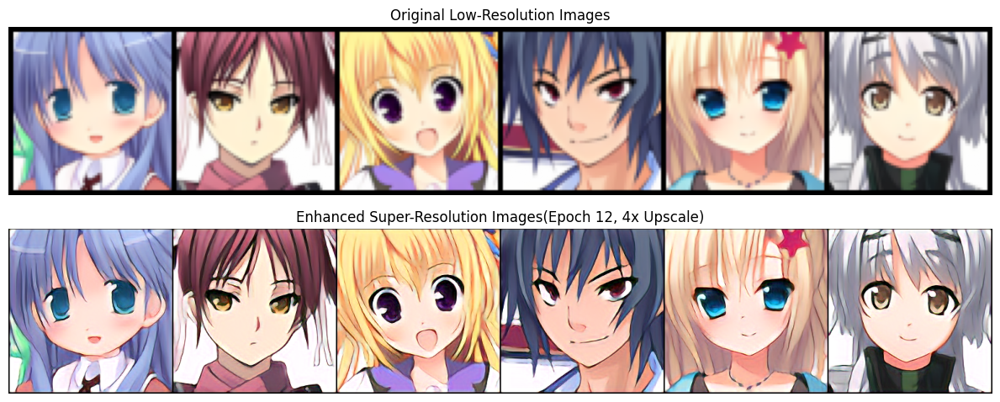

Epoch [13/25], Batch [0/313] => Discriminator Loss: 0.0982, Generator Loss: 0.0078, Batch Time: 5.1702
Epoch [13/25], Batch [10/313] => Discriminator Loss: 0.1962, Generator Loss: 0.0079, Batch Time: 5.4900
Epoch [13/25], Batch [20/313] => Discriminator Loss: 0.1079, Generator Loss: 0.0070, Batch Time: 4.2256
Epoch [13/25], Batch [30/313] => Discriminator Loss: 0.1021, Generator Loss: 0.0061, Batch Time: 4.5331
Epoch [13/25], Batch [40/313] => Discriminator Loss: 0.0863, Generator Loss: 0.0061, Batch Time: 4.0012
Epoch [13/25], Batch [50/313] => Discriminator Loss: 0.1283, Generator Loss: 0.0067, Batch Time: 5.2192
Epoch [13/25], Batch [60/313] => Discriminator Loss: 0.1075, Generator Loss: 0.0090, Batch Time: 4.7142
Epoch [13/25], Batch [70/313] => Discriminator Loss: 0.1623, Generator Loss: 0.0098, Batch Time: 4.8125
Epoch [13/25], Batch [80/313] => Discriminator Loss: 0.1051, Generator Loss: 0.0068, Batch Time: 4.7964
Epoch [13/25], Batch [90/313] => Discriminator Loss: 0.1746, Gene

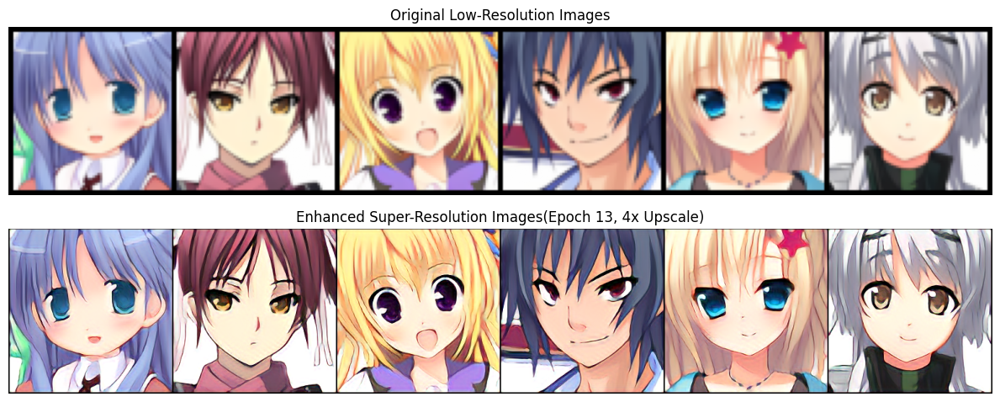

Epoch [14/25], Batch [0/313] => Discriminator Loss: 0.1405, Generator Loss: 0.0067, Batch Time: 6.2193
Epoch [14/25], Batch [10/313] => Discriminator Loss: 0.1513, Generator Loss: 0.0054, Batch Time: 4.8104
Epoch [14/25], Batch [20/313] => Discriminator Loss: 0.2936, Generator Loss: 0.0092, Batch Time: 5.2019
Epoch [14/25], Batch [30/313] => Discriminator Loss: 0.1957, Generator Loss: 0.0072, Batch Time: 6.5869
Epoch [14/25], Batch [40/313] => Discriminator Loss: 0.2267, Generator Loss: 0.0066, Batch Time: 5.7568
Epoch [14/25], Batch [50/313] => Discriminator Loss: 0.1358, Generator Loss: 0.0055, Batch Time: 4.5175
Epoch [14/25], Batch [60/313] => Discriminator Loss: 0.1618, Generator Loss: 0.0062, Batch Time: 4.8147
Epoch [14/25], Batch [70/313] => Discriminator Loss: 0.0649, Generator Loss: 0.0052, Batch Time: 4.4089
Epoch [14/25], Batch [80/313] => Discriminator Loss: 0.0888, Generator Loss: 0.0078, Batch Time: 4.6095
Epoch [14/25], Batch [90/313] => Discriminator Loss: 0.0829, Gene

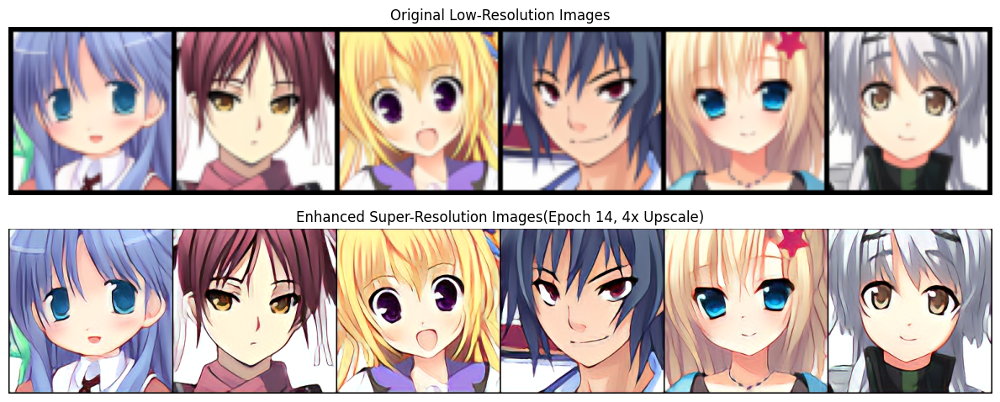

Epoch [15/25], Batch [0/313] => Discriminator Loss: 0.1795, Generator Loss: 0.0070, Batch Time: 5.9270
Epoch [15/25], Batch [10/313] => Discriminator Loss: 0.0919, Generator Loss: 0.0060, Batch Time: 7.0326
Epoch [15/25], Batch [20/313] => Discriminator Loss: 0.1347, Generator Loss: 0.0070, Batch Time: 4.0364
Epoch [15/25], Batch [30/313] => Discriminator Loss: 0.1793, Generator Loss: 0.0084, Batch Time: 4.0180
Epoch [15/25], Batch [40/313] => Discriminator Loss: 0.1273, Generator Loss: 0.0086, Batch Time: 5.6937
Epoch [15/25], Batch [50/313] => Discriminator Loss: 0.1327, Generator Loss: 0.0048, Batch Time: 8.5012
Epoch [15/25], Batch [60/313] => Discriminator Loss: 0.1551, Generator Loss: 0.0086, Batch Time: 7.9192
Epoch [15/25], Batch [70/313] => Discriminator Loss: 0.1953, Generator Loss: 0.0052, Batch Time: 9.0885
Epoch [15/25], Batch [80/313] => Discriminator Loss: 0.1860, Generator Loss: 0.0087, Batch Time: 4.3434
Epoch [15/25], Batch [90/313] => Discriminator Loss: 0.1349, Gene

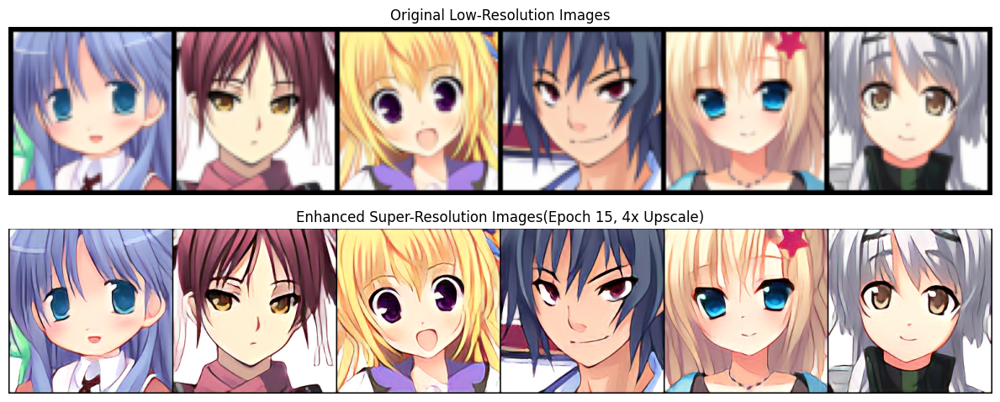

Epoch [16/25], Batch [0/313] => Discriminator Loss: 0.1368, Generator Loss: 0.0053, Batch Time: 4.9767
Epoch [16/25], Batch [10/313] => Discriminator Loss: 0.2336, Generator Loss: 0.0059, Batch Time: 4.8048
Epoch [16/25], Batch [20/313] => Discriminator Loss: 0.1974, Generator Loss: 0.0068, Batch Time: 5.0821
Epoch [16/25], Batch [30/313] => Discriminator Loss: 0.0954, Generator Loss: 0.0051, Batch Time: 5.8056
Epoch [16/25], Batch [40/313] => Discriminator Loss: 0.1392, Generator Loss: 0.0079, Batch Time: 5.0458
Epoch [16/25], Batch [50/313] => Discriminator Loss: 0.1123, Generator Loss: 0.0065, Batch Time: 4.4289
Epoch [16/25], Batch [60/313] => Discriminator Loss: 0.1525, Generator Loss: 0.0070, Batch Time: 3.9391
Epoch [16/25], Batch [70/313] => Discriminator Loss: 0.1774, Generator Loss: 0.0064, Batch Time: 5.4119
Epoch [16/25], Batch [80/313] => Discriminator Loss: 0.1068, Generator Loss: 0.0049, Batch Time: 4.0089
Epoch [16/25], Batch [90/313] => Discriminator Loss: 0.1324, Gene

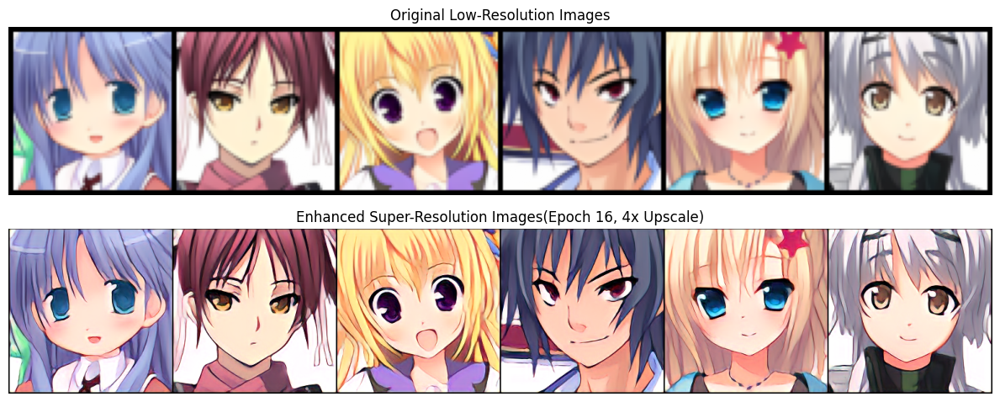

Epoch [17/25], Batch [0/313] => Discriminator Loss: 0.2242, Generator Loss: 0.0066, Batch Time: 7.5308
Epoch [17/25], Batch [10/313] => Discriminator Loss: 0.1455, Generator Loss: 0.0061, Batch Time: 5.3322
Epoch [17/25], Batch [20/313] => Discriminator Loss: 0.1113, Generator Loss: 0.0055, Batch Time: 4.4217
Epoch [17/25], Batch [30/313] => Discriminator Loss: 0.1734, Generator Loss: 0.0087, Batch Time: 3.9994
Epoch [17/25], Batch [40/313] => Discriminator Loss: 0.2063, Generator Loss: 0.0064, Batch Time: 4.0005
Epoch [17/25], Batch [50/313] => Discriminator Loss: 0.1827, Generator Loss: 0.0073, Batch Time: 3.9767
Epoch [17/25], Batch [60/313] => Discriminator Loss: 0.2460, Generator Loss: 0.0075, Batch Time: 4.7328
Epoch [17/25], Batch [70/313] => Discriminator Loss: 0.2678, Generator Loss: 0.0121, Batch Time: 6.5674
Epoch [17/25], Batch [80/313] => Discriminator Loss: 0.1379, Generator Loss: 0.0084, Batch Time: 6.2540
Epoch [17/25], Batch [90/313] => Discriminator Loss: 0.1753, Gene

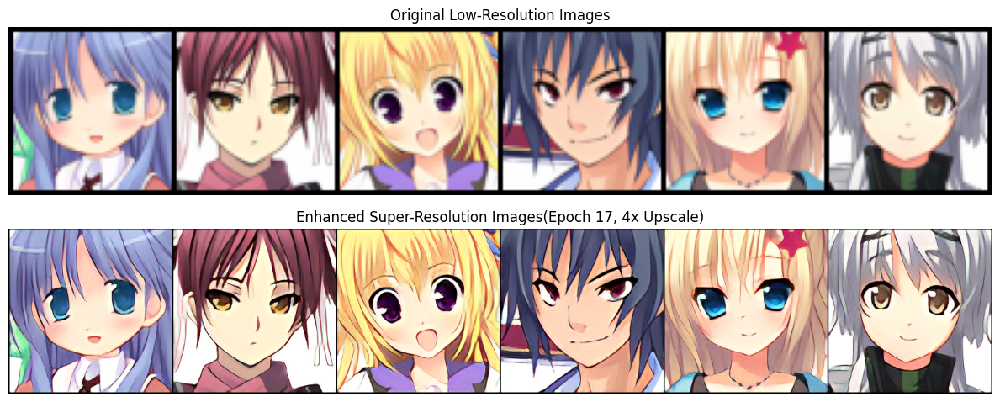

Epoch [18/25], Batch [0/313] => Discriminator Loss: 0.4015, Generator Loss: 0.0060, Batch Time: 7.4839
Epoch [18/25], Batch [10/313] => Discriminator Loss: 0.0747, Generator Loss: 0.0079, Batch Time: 4.6635
Epoch [18/25], Batch [20/313] => Discriminator Loss: 0.1231, Generator Loss: 0.0057, Batch Time: 4.7151
Epoch [18/25], Batch [30/313] => Discriminator Loss: 0.0988, Generator Loss: 0.0063, Batch Time: 4.9665
Epoch [18/25], Batch [40/313] => Discriminator Loss: 0.2679, Generator Loss: 0.0076, Batch Time: 4.0600
Epoch [18/25], Batch [50/313] => Discriminator Loss: 0.2176, Generator Loss: 0.0066, Batch Time: 5.1502
Epoch [18/25], Batch [60/313] => Discriminator Loss: 0.1997, Generator Loss: 0.0051, Batch Time: 5.3087
Epoch [18/25], Batch [70/313] => Discriminator Loss: 0.2117, Generator Loss: 0.0052, Batch Time: 11.5081
Epoch [18/25], Batch [80/313] => Discriminator Loss: 0.4154, Generator Loss: 0.0089, Batch Time: 4.3760
Epoch [18/25], Batch [90/313] => Discriminator Loss: 0.2227, Gen

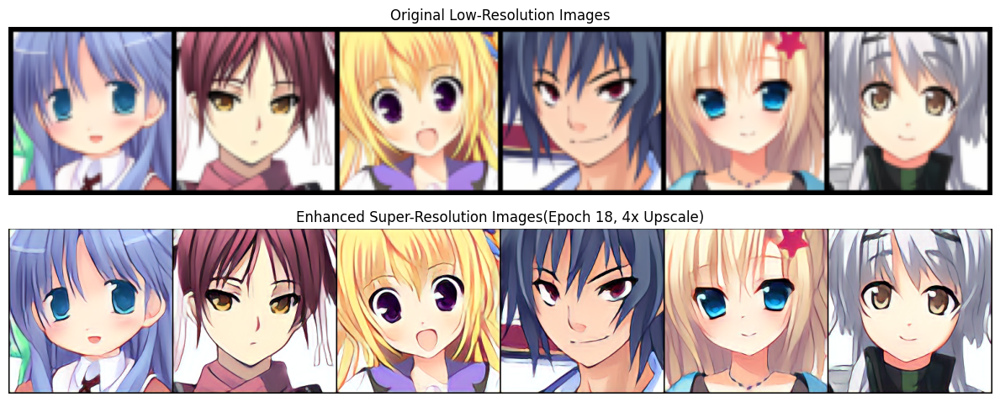

Epoch [19/25], Batch [0/313] => Discriminator Loss: 0.2016, Generator Loss: 0.0059, Batch Time: 6.4853
Epoch [19/25], Batch [10/313] => Discriminator Loss: 0.1257, Generator Loss: 0.0053, Batch Time: 4.0132
Epoch [19/25], Batch [20/313] => Discriminator Loss: 0.3803, Generator Loss: 0.0057, Batch Time: 4.0823
Epoch [19/25], Batch [30/313] => Discriminator Loss: 0.2563, Generator Loss: 0.0078, Batch Time: 4.0315
Epoch [19/25], Batch [40/313] => Discriminator Loss: 0.1913, Generator Loss: 0.0071, Batch Time: 5.3294
Epoch [19/25], Batch [50/313] => Discriminator Loss: 0.1171, Generator Loss: 0.0076, Batch Time: 5.2488
Epoch [19/25], Batch [60/313] => Discriminator Loss: 0.1890, Generator Loss: 0.0053, Batch Time: 6.3506
Epoch [19/25], Batch [70/313] => Discriminator Loss: 0.2611, Generator Loss: 0.0068, Batch Time: 4.5321
Epoch [19/25], Batch [80/313] => Discriminator Loss: 0.1941, Generator Loss: 0.0045, Batch Time: 3.9971
Epoch [19/25], Batch [90/313] => Discriminator Loss: 0.1179, Gene

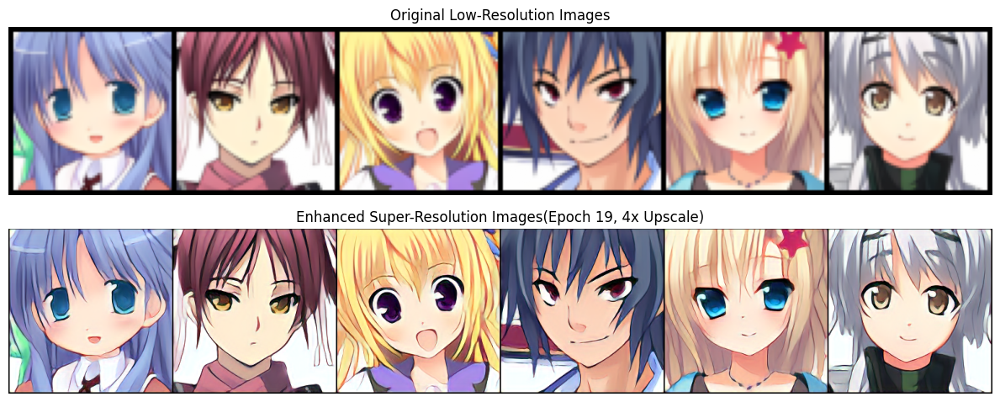

Epoch [20/25], Batch [0/313] => Discriminator Loss: 0.2121, Generator Loss: 0.0101, Batch Time: 5.3437
Epoch [20/25], Batch [10/313] => Discriminator Loss: 0.1984, Generator Loss: 0.0046, Batch Time: 6.0976
Epoch [20/25], Batch [20/313] => Discriminator Loss: 0.2334, Generator Loss: 0.0043, Batch Time: 5.4493
Epoch [20/25], Batch [30/313] => Discriminator Loss: 0.2849, Generator Loss: 0.0079, Batch Time: 8.2989
Epoch [20/25], Batch [40/313] => Discriminator Loss: 0.1827, Generator Loss: 0.0079, Batch Time: 5.3202
Epoch [20/25], Batch [50/313] => Discriminator Loss: 0.3691, Generator Loss: 0.0041, Batch Time: 4.0835
Epoch [20/25], Batch [60/313] => Discriminator Loss: 0.1183, Generator Loss: 0.0044, Batch Time: 4.7174
Epoch [20/25], Batch [70/313] => Discriminator Loss: 0.5654, Generator Loss: 0.0092, Batch Time: 4.6563
Epoch [20/25], Batch [80/313] => Discriminator Loss: 0.2556, Generator Loss: 0.0063, Batch Time: 12.9096
Epoch [20/25], Batch [90/313] => Discriminator Loss: 0.3161, Gen

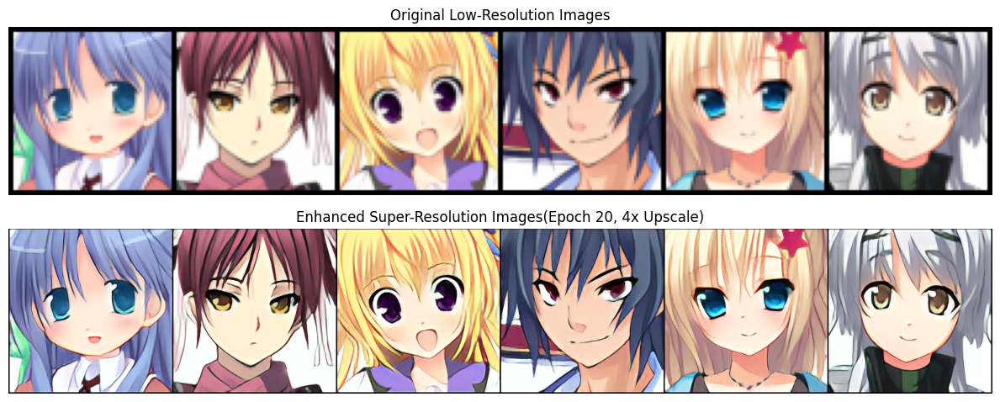

Epoch [21/25], Batch [0/313] => Discriminator Loss: 0.1800, Generator Loss: 0.0045, Batch Time: 13.0169
Epoch [21/25], Batch [10/313] => Discriminator Loss: 0.1709, Generator Loss: 0.0074, Batch Time: 4.8904
Epoch [21/25], Batch [20/313] => Discriminator Loss: 0.2094, Generator Loss: 0.0049, Batch Time: 10.0108
Epoch [21/25], Batch [30/313] => Discriminator Loss: 0.1572, Generator Loss: 0.0045, Batch Time: 5.3092
Epoch [21/25], Batch [40/313] => Discriminator Loss: 0.1473, Generator Loss: 0.0068, Batch Time: 4.5902
Epoch [21/25], Batch [50/313] => Discriminator Loss: 0.1886, Generator Loss: 0.0055, Batch Time: 4.8084
Epoch [21/25], Batch [60/313] => Discriminator Loss: 0.1219, Generator Loss: 0.0045, Batch Time: 8.5147
Epoch [21/25], Batch [70/313] => Discriminator Loss: 0.2149, Generator Loss: 0.0067, Batch Time: 4.0234
Epoch [21/25], Batch [80/313] => Discriminator Loss: 0.1780, Generator Loss: 0.0045, Batch Time: 5.2141
Epoch [21/25], Batch [90/313] => Discriminator Loss: 0.1805, Ge

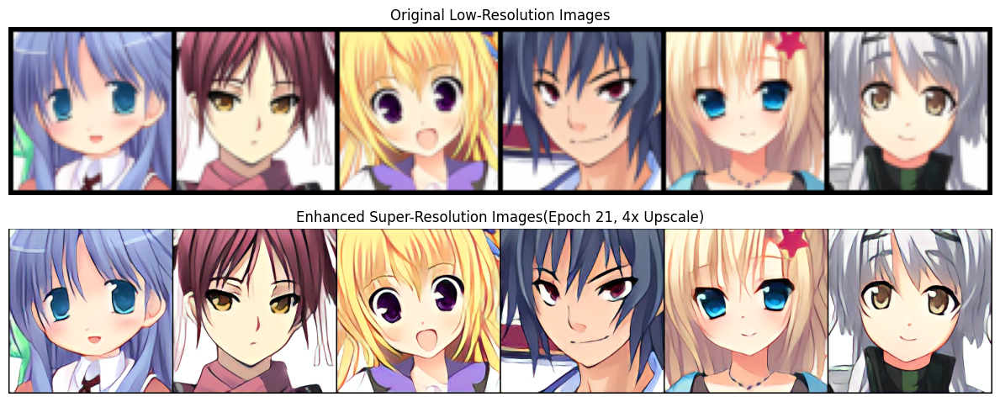

Epoch [22/25], Batch [0/313] => Discriminator Loss: 0.1954, Generator Loss: 0.0066, Batch Time: 5.1007
Epoch [22/25], Batch [10/313] => Discriminator Loss: 0.1635, Generator Loss: 0.0054, Batch Time: 4.3225
Epoch [22/25], Batch [20/313] => Discriminator Loss: 0.1709, Generator Loss: 0.0053, Batch Time: 4.7455
Epoch [22/25], Batch [30/313] => Discriminator Loss: 0.2573, Generator Loss: 0.0059, Batch Time: 5.2154
Epoch [22/25], Batch [40/313] => Discriminator Loss: 0.1643, Generator Loss: 0.0049, Batch Time: 5.5647
Epoch [22/25], Batch [50/313] => Discriminator Loss: 0.2121, Generator Loss: 0.0045, Batch Time: 18.2854
Epoch [22/25], Batch [60/313] => Discriminator Loss: 0.2024, Generator Loss: 0.0063, Batch Time: 5.2559
Epoch [22/25], Batch [70/313] => Discriminator Loss: 0.2154, Generator Loss: 0.0049, Batch Time: 5.2110
Epoch [22/25], Batch [80/313] => Discriminator Loss: 0.2253, Generator Loss: 0.0044, Batch Time: 4.8113
Epoch [22/25], Batch [90/313] => Discriminator Loss: 0.2125, Gen

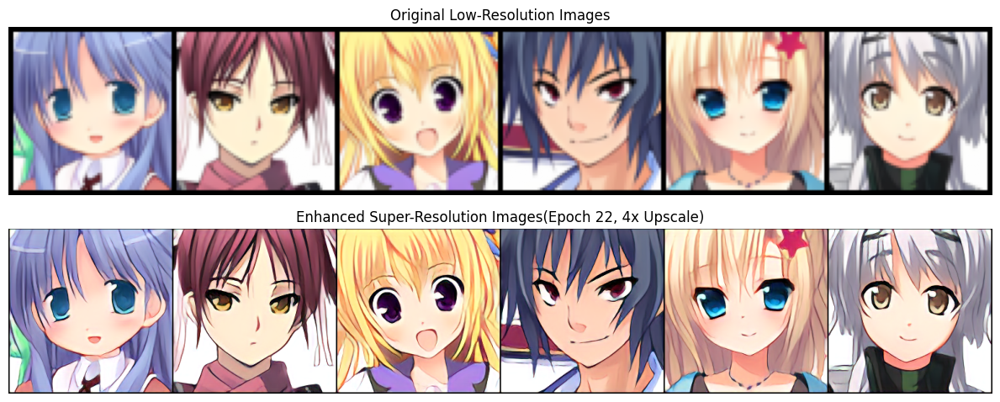

Epoch [23/25], Batch [0/313] => Discriminator Loss: 0.1531, Generator Loss: 0.0047, Batch Time: 4.9209
Epoch [23/25], Batch [10/313] => Discriminator Loss: 0.2892, Generator Loss: 0.0078, Batch Time: 4.0738
Epoch [23/25], Batch [20/313] => Discriminator Loss: 0.1587, Generator Loss: 0.0054, Batch Time: 6.2512
Epoch [23/25], Batch [30/313] => Discriminator Loss: 0.1820, Generator Loss: 0.0054, Batch Time: 4.2531
Epoch [23/25], Batch [40/313] => Discriminator Loss: 0.2468, Generator Loss: 0.0066, Batch Time: 4.3025
Epoch [23/25], Batch [50/313] => Discriminator Loss: 0.1562, Generator Loss: 0.0055, Batch Time: 4.1092
Epoch [23/25], Batch [60/313] => Discriminator Loss: 0.1325, Generator Loss: 0.0059, Batch Time: 4.0370
Epoch [23/25], Batch [70/313] => Discriminator Loss: 0.2136, Generator Loss: 0.0044, Batch Time: 4.0029
Epoch [23/25], Batch [80/313] => Discriminator Loss: 0.1780, Generator Loss: 0.0060, Batch Time: 4.4570
Epoch [23/25], Batch [90/313] => Discriminator Loss: 0.1678, Gene

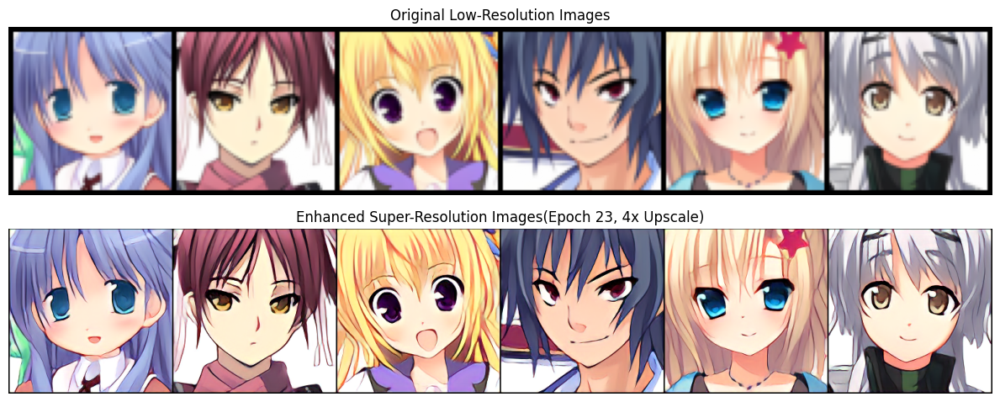

Epoch [24/25], Batch [0/313] => Discriminator Loss: 0.2779, Generator Loss: 0.0055, Batch Time: 5.6729
Epoch [24/25], Batch [10/313] => Discriminator Loss: 0.1850, Generator Loss: 0.0055, Batch Time: 5.0470
Epoch [24/25], Batch [20/313] => Discriminator Loss: 0.2302, Generator Loss: 0.0044, Batch Time: 4.2130
Epoch [24/25], Batch [30/313] => Discriminator Loss: 0.2138, Generator Loss: 0.0047, Batch Time: 5.0271
Epoch [24/25], Batch [40/313] => Discriminator Loss: 0.1396, Generator Loss: 0.0061, Batch Time: 4.0695
Epoch [24/25], Batch [50/313] => Discriminator Loss: 0.1370, Generator Loss: 0.0047, Batch Time: 4.4404
Epoch [24/25], Batch [60/313] => Discriminator Loss: 0.1714, Generator Loss: 0.0060, Batch Time: 4.5170
Epoch [24/25], Batch [70/313] => Discriminator Loss: 0.2353, Generator Loss: 0.0060, Batch Time: 5.0463
Epoch [24/25], Batch [80/313] => Discriminator Loss: 0.1670, Generator Loss: 0.0039, Batch Time: 5.2272
Epoch [24/25], Batch [90/313] => Discriminator Loss: 0.1586, Gene

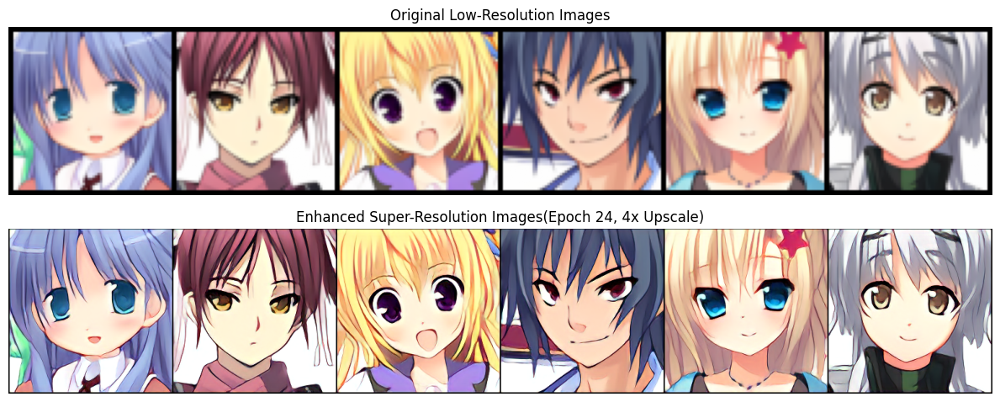

Epoch [25/25], Batch [0/313] => Discriminator Loss: 0.3050, Generator Loss: 0.0067, Batch Time: 5.0506
Epoch [25/25], Batch [10/313] => Discriminator Loss: 0.1204, Generator Loss: 0.0045, Batch Time: 4.3958
Epoch [25/25], Batch [20/313] => Discriminator Loss: 0.2886, Generator Loss: 0.0057, Batch Time: 4.1029
Epoch [25/25], Batch [30/313] => Discriminator Loss: 0.2871, Generator Loss: 0.0035, Batch Time: 3.9926
Epoch [25/25], Batch [40/313] => Discriminator Loss: 0.1159, Generator Loss: 0.0040, Batch Time: 5.3850
Epoch [25/25], Batch [50/313] => Discriminator Loss: 0.3584, Generator Loss: 0.0074, Batch Time: 4.9737
Epoch [25/25], Batch [60/313] => Discriminator Loss: 0.2617, Generator Loss: 0.0033, Batch Time: 4.0918
Epoch [25/25], Batch [70/313] => Discriminator Loss: 0.0991, Generator Loss: 0.0041, Batch Time: 4.9101
Epoch [25/25], Batch [80/313] => Discriminator Loss: 0.3495, Generator Loss: 0.0098, Batch Time: 4.0005
Epoch [25/25], Batch [90/313] => Discriminator Loss: 0.2519, Gene

In [22]:
lr_images_sample, hr_images_sample = next(iter(dataloader))
lr_images_sample = lr_images_sample.to(device)

for epoch in range(num_epochs):
    epoch_start_time = time.time()
    generator.train()
    discriminator.train()

    # Plot images only once before each epoch
    with torch.no_grad():
        sr_images_sample = torch.clamp(generator(lr_images_sample), 0, 1)
    plot_and_save_images(lr_images_sample, sr_images_sample, epoch)

    
    for batch_idx, (lr_images, hr_images) in enumerate(dataloader):
        batch_start_time = time.time()
        # Move images to device
        lr_images = lr_images.to(device)
        hr_images = hr_images.to(device)

        # Create target labels for discriminator training
        valid_labels = torch.ones((lr_images.size(0), 1, hr_images.size(2), hr_images.size(3)),
                                    requires_grad=False).to(device)
        fake_labels = torch.zeros((lr_images.size(0), 1, hr_images.size(2), hr_images.size(3)),
                                   requires_grad=False).to(device)

        # Generate super-resolved images from low-resolution images
        sr_images = generator(lr_images)  # e.g. 64x64 --> 128x128 or 64x64 --> 256x256

        # Clamp images to valid range [0, 1]
        sr_images = torch.clamp(sr_images, 0, 1)
        lr_images = torch.clamp(lr_images, 0, 1)

        # ---------------------
        # Train Discriminator
        # ---------------------
        optimizer_d.zero_grad()  # Reset gradients for discriminator
        real_preds = discriminator(hr_images)
        fake_preds = discriminator(sr_images.detach())
        d_loss = relativistic_loss(real_preds, fake_preds)
        d_loss.backward()
        optimizer_d.step()

        # ---------------------
        # Train Generator
        # ---------------------
        optimizer_g.zero_grad()  # Reset gradients for generator
        fake_preds = discriminator(sr_images)
        fake_preds = fake_preds.view_as(valid_labels)
        g_adv_loss = adversarial_loss(fake_preds, valid_labels)
        g_content_loss = content_loss(sr_images, hr_images)
        g_perceptual_loss = feature_extractor(sr_images, hr_images)
        g_loss = g_content_loss + g_adv_loss * 1e-3 + g_perceptual_loss * 1e-2
        g_loss.backward()
        optimizer_g.step()

        # Save losses
        generator_losses.append(g_loss.item())
        discriminator_losses.append(d_loss.item())

        batch_end_time = time.time()

        if batch_idx % 10 == 0:
            print(f'Epoch [{epoch + 1}/{num_epochs}], Batch [{batch_idx}/{len(dataloader)}] ', end="=> ")
            print(f'Discriminator Loss: {d_loss.item():.4f}, Generator Loss: {g_loss.item():.4f}', end=", ")
            print(f"Batch Time: {(batch_end_time - batch_start_time):.4f}")

        # Cleanup to free memory
        del fake_preds, g_adv_loss, g_content_loss, g_perceptual_loss, g_loss, sr_images, lr_images, hr_images
        if device == torch.device("cuda"):
            torch.cuda.empty_cache()
        elif device == torch.device("mps"):
            torch.mps.empty_cache()

    # Update learning rate schedulers
    scheduler_g.step()
    scheduler_d.step()
    epoch_end_time = time.time()
    print("Epoch Time:", epoch_end_time - epoch_start_time)

    # Save model checkpoint
    torch.save({
        'generator_state_dict': generator.state_dict(),
        'epoch': epoch,
    }, f'models/generator_{upscale_factor}x_epoch_{epoch + 1}.pth')


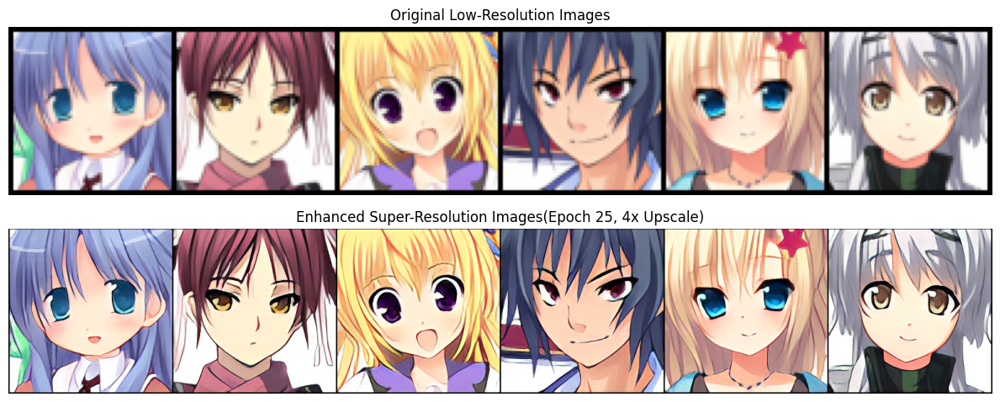

In [25]:
with torch.no_grad():
    sr_images_sample = torch.clamp(generator(lr_images_sample), 0, 1)
plot_and_save_images(lr_images_sample, sr_images_sample, num_epochs)

In [23]:
torch.save({
'generator_state_dict': generator.state_dict(),
'epoch': num_epochs,
}, f'models/final_generator_{upscale_factor}x.pth')
print(f'Latest model checkpoint saved')

# Save final loss data
loss_data = {
    "generator_losses": generator_losses,
    "discriminator_losses": discriminator_losses
}

with open(f"models/losses_final_{upscale_factor}x.json", "w") as f:
    json.dump(loss_data, f)

print(f"Final loss data saved in models/losses_final_{upscale_factor}x.json")

Latest model checkpoint saved
Final loss data saved in models/losses_final_4x.json


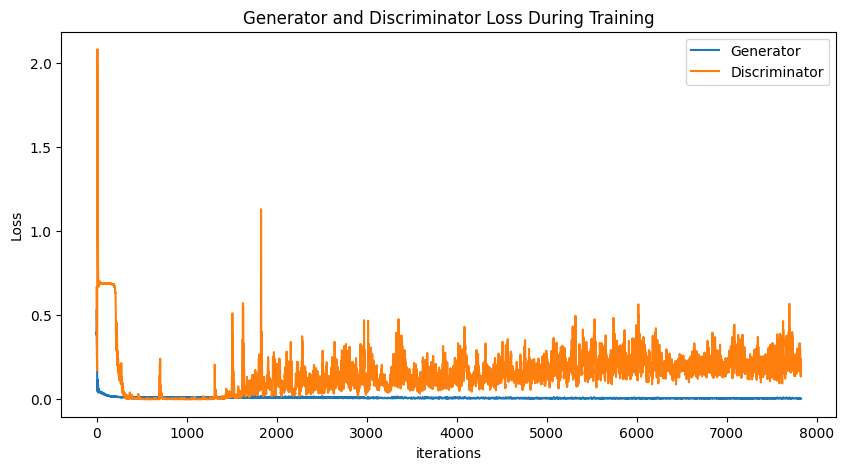

In [24]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(generator_losses,label="Generator")
plt.plot(discriminator_losses,label="Discriminator")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()